In [22]:
import pandas as pd
import json
import numpy as np
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2
import sys
import os
sys.path.insert(0, '../')
from scripts.tracking import MatchTracking 
from scripts.pass_events import PassEvents
from scripts.ball_visualization import BallVisualization

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [23]:
data_directory = r'..\data\tracking'
file = 'g2312213_SecondSpectrum_tracking-produced.jsonl'
match_tracking_path = os.path.join(data_directory, file)
match_tracking = MatchTracking(tracking_file_path=match_tracking_path)

In [24]:
data_directory = r'..\data\statsbomb'
file = 'ManCity_Tottenham_events.json'
events_path = os.path.join(data_directory, file)
pass_events = PassEvents(tracking_file_path=events_path)

In [36]:
BV = BallVisualization(match_tracking, pass_events, period = 1)

In [45]:
BV.plot(start = 0, end = 40, 0.1)

In [40]:
import plotly.graph_objects as go
import numpy as np

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0,10,0.1):
    x = BV.df_merged.loc[BV.df_merged['gameClock']<=step,'x'].to_list()
    y = BV.df_merged.loc[BV.df_merged['gameClock']<=step,'y'].to_list()
    c = BV.df_merged.loc[BV.df_merged['gameClock']<=step,'color'].to_list()
    fig.add_trace(
        go.Scatter(
            visible=False,
            x=x,
            y=y,
            mode = 'markers',
            marker_color=c))
    
fig.update_layout(yaxis_range=[-BV.pitchWidth/2,BV.pitchWidth/2])
fig.update_layout(xaxis_range=[-BV.pitchLength/2,BV.pitchLength/2])
fig.update_layout(
    autosize=False,
    width=BV.pitchLength*10,
    height=BV.pitchWidth*10,
    plot_bgcolor = '#09CE00'
)

# Make 10th trace visible
fig.data[0].visible = True
fig.update_layout(xaxis_showgrid=False, yaxis_showgrid=False)
fig.update_layout(yaxis_zeroline=False)
fig.update_polars(radialaxis_showline=False)
fig.add_shape(type="line", x0=-BV.pitchLength/2, y0=40.3/2, x1=-BV.pitchLength/2+16.5, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=-BV.pitchLength/2, y0=-40.3/2, x1=-BV.pitchLength/2+16.5, y1=-40.3/2, line_color="white")
fig.add_shape(type="line", x0=BV.pitchLength/2-16.5, y0=40.3/2, x1=BV.pitchLength/2, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=BV.pitchLength/2-16.5, y0=-40.3/2, x1=BV.pitchLength/2, y1=-40.3/2, line_color="white")
fig.add_shape(type="line", x0=-BV.pitchLength/2+16.5, y0=-40.3/2, x1=-BV.pitchLength/2+16.5, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=BV.pitchLength/2-16.5, y0=-40.3/2, x1=BV.pitchLength/2-16.5, y1=40.3/2, line_color="white")

fig.add_shape(type="line", x0=-BV.pitchLength/2, y0=18.3/2, x1=-BV.pitchLength/2+5.5, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=-BV.pitchLength/2, y0=-18.3/2, x1=-BV.pitchLength/2+5.5, y1=-18.3/2, line_color="white")
fig.add_shape(type="line", x0=BV.pitchLength/2-5.5, y0=18.3/2, x1=BV.pitchLength/2, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=BV.pitchLength/2-5.5, y0=-18.3/2, x1=BV.pitchLength/2, y1=-18.3/2, line_color="white")
fig.add_shape(type="line", x0=-BV.pitchLength/2+5.5, y0=-18.3/2, x1=-BV.pitchLength/2+5.5, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=BV.pitchLength/2-5.5, y0=-18.3/2, x1=BV.pitchLength/2-5.5, y1=18.3/2, line_color="white")

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Slider switched to step: " + str(i)}],  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

fig.show()

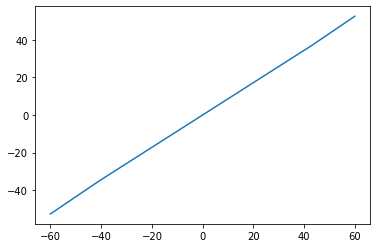

In [172]:
def x_stats_to_track(x):
    if np.abs(x)<=42:
        return (data_meta['pitchLength']-33)/84 * x
    elif x > 42:
        return 16.5/18 * (x-42) + data_meta['pitchLength']/2 - 16.5
    else:
        return 16.5/18 * (x+42) - data_meta['pitchLength']/2 + 16.5

xs = np.arange(-60,60,0.1)
y = [x_stats_to_track(i) for i in xs]
plt.plot(xs,y)

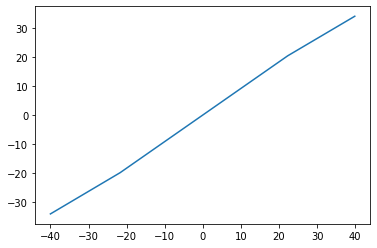

In [173]:
def y_stats_to_track(x):
    if np.abs(x)<=22:
        return 20.15/22 * x
    elif x > 22:
        return (data_meta['pitchWidth']/2 - 20.15) / 18 * (x-22) + 20.15
    else:
        return (data_meta['pitchWidth']/2 - 20.15) / 18 * (x+22) - 20.15

xs = np.arange(-40,40,0.1)
y = [y_stats_to_track(i) for i in xs]
plt.plot(xs,y)

In [174]:
df_tot.loc[df_tot['type']=='pass','ball_x'] = df_tot.loc[df_tot['type']=='pass','ball_x'].apply(x_stats_to_track)
df_tot.loc[df_tot['type']=='pass','ball_y'] = df_tot.loc[df_tot['type']=='pass','ball_y'].apply(y_stats_to_track)
df_tot.loc[df_tot['type']=='reception','ball_x'] = df_tot.loc[df_tot['type']=='reception','ball_x'].apply(x_stats_to_track)
df_tot.loc[df_tot['type']=='reception','ball_y'] = df_tot.loc[df_tot['type']=='reception','ball_y'].apply(y_stats_to_track)

In [175]:
import plotly.graph_objects as go
import numpy as np

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0,10,0.1):
    x = df_tot.loc[df_tot['gameClock']<=step,'ball_x'].to_list()
    y = df_tot.loc[df_tot['gameClock']<=step,'ball_y'].to_list()
    c = df_tot.loc[df_tot['gameClock']<=step,'color'].to_list()
    fig.add_trace(
        go.Scatter(
            visible=False,
            x=x,
            y=y,
            mode = 'markers',
            marker_color=c))
    
fig.update_layout(yaxis_range=[-data_meta['pitchWidth']/2,data_meta['pitchWidth']/2])
fig.update_layout(xaxis_range=[-data_meta['pitchLength']/2,data_meta['pitchLength']/2])
fig.update_layout(
    autosize=False,
    width=data_meta['pitchLength']*10,
    height=data_meta['pitchWidth']*10,
    plot_bgcolor = '#09CE00'
)

# Make 10th trace visible
fig.data[0].visible = True
fig.update_layout(xaxis_showgrid=False, yaxis_showgrid=False)
fig.update_layout(yaxis_zeroline=False)
fig.update_polars(radialaxis_showline=False)
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=40.3/2, x1=-data_meta['pitchLength']/2+16.5, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=-40.3/2, x1=-data_meta['pitchLength']/2+16.5, y1=-40.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-16.5, y0=40.3/2, x1=data_meta['pitchLength']/2, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-16.5, y0=-40.3/2, x1=data_meta['pitchLength']/2, y1=-40.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2+16.5, y0=-40.3/2, x1=-data_meta['pitchLength']/2+16.5, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-16.5, y0=-40.3/2, x1=data_meta['pitchLength']/2-16.5, y1=40.3/2, line_color="white")

fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=18.3/2, x1=-data_meta['pitchLength']/2+5.5, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=-18.3/2, x1=-data_meta['pitchLength']/2+5.5, y1=-18.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-5.5, y0=18.3/2, x1=data_meta['pitchLength']/2, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-5.5, y0=-18.3/2, x1=data_meta['pitchLength']/2, y1=-18.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2+5.5, y0=-18.3/2, x1=-data_meta['pitchLength']/2+5.5, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-5.5, y0=-18.3/2, x1=data_meta['pitchLength']/2-5.5, y1=18.3/2, line_color="white")

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Slider switched to step: " + str(i)}],  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

fig.show()

## Synchronization

In [176]:
df_pass

,gameClock,ball_x,ball_y,type
4,0.194000,-1.0,0.1,pass
4,1.036353,8.9,4.6,reception
7,1.691000,9.2,5.6,pass
7,2.903667,25.2,10.8,reception
10,3.965000,25.5,11.0,pass
...,...,...,...,...
1727,2764.352732,50.4,-3.5,reception
1735,2826.321000,-1.0,0.1,pass
1735,2827.129571,9.7,3.4,reception
1738,2828.824000,9.6,3.7,pass


In [177]:
df_pass['ball_x'] = df_pass['ball_x'].apply(x_stats_to_track)
df_pass['ball_y'] = df_pass['ball_y'].apply(y_stats_to_track)

In [178]:
pd.options.mode.chained_assignment = None 
def ball_position_error(delta, df_pass, df_tracking):
    df_pass_copy = df_pass.copy()
    df_pass_copy = df_pass_copy.rename(columns = {'ball_x' : 'pass_x', 'ball_y' : 'pass_y'}, )
    df_pass_copy['gameClock'] -= delta
    df_pass_copy = df_pass_copy.sort_values('gameClock')
    df_err = pd.merge_asof(df_pass_copy, df_tracking, on = 'gameClock', direction='nearest')
    df_err['dist_moy'] = np.sqrt((df_err['pass_x']-df_err['ball_x'])**2 + (df_err['pass_y']-df_err['ball_y'])**2)
    return df_err['dist_moy'].mean()

In [179]:
err = ball_position_error(0,df_pass,df_tracking)
print(err)

5.710547540774974


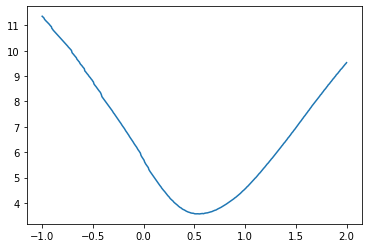

In [180]:
deltas = np.linspace(-1,2,500)
errs = [ball_position_error(delta,df_pass,df_tracking) for delta in deltas]
plt.plot(deltas,errs)
plt.show()

In [181]:
min_value = min(errs)
deltas[errs.index(min(errs))]

0.5511022044088176

In [182]:
df_tot_synch = df_tot.copy()
df_tot_synch.loc[df_tot_synch['type']=='pass','gameClock'] = df_tot_synch.loc[df_tot_synch['type']=='pass','gameClock'] - deltas[errs.index(min(errs))]
df_tot_synch.loc[df_tot_synch['type']=='reception','gameClock'] = df_tot_synch.loc[df_tot_synch['type']=='reception','gameClock'] - deltas[errs.index(min(errs))]

In [183]:
import plotly.graph_objects as go
import numpy as np

# Create figure
fig = go.Figure()
# & (df_tot['gameClock']>np.max([0,step-5]))
# Add traces, one for each slider step
for step in np.arange(0,20,0.05):
    x = df_tot.loc[(df_tot_synch['gameClock']<=step),'ball_x'].to_list()
    y = df_tot.loc[(df_tot['gameClock']<=step),'ball_y'].to_list()
    c = df_tot.loc[(df_tot_synch['gameClock']<=step),'color'].to_list()
    fig.add_trace(
        go.Scatter(
            visible=False,
            x=x,
            y=y,
            mode = 'markers',
            marker_color=c))
    
fig.update_layout(yaxis_range=[-data_meta['pitchWidth']/2,data_meta['pitchWidth']/2])
fig.update_layout(xaxis_range=[-data_meta['pitchLength']/2,data_meta['pitchLength']/2])
fig.update_layout(
    autosize=False,
    width=data_meta['pitchLength']*10,
    height=data_meta['pitchWidth']*10,
    plot_bgcolor = '#09CE00'
)

# Make 10th trace visible
fig.data[0].visible = True
fig.update_layout(xaxis_showgrid=False, yaxis_showgrid=False)
fig.update_layout(yaxis_zeroline=False)
fig.update_polars(radialaxis_showline=False)
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=40.3/2, x1=-data_meta['pitchLength']/2+16.5, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=-40.3/2, x1=-data_meta['pitchLength']/2+16.5, y1=-40.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-16.5, y0=40.3/2, x1=data_meta['pitchLength']/2, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-16.5, y0=-40.3/2, x1=data_meta['pitchLength']/2, y1=-40.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2+16.5, y0=-40.3/2, x1=-data_meta['pitchLength']/2+16.5, y1=40.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-16.5, y0=-40.3/2, x1=data_meta['pitchLength']/2-16.5, y1=40.3/2, line_color="white")

fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=18.3/2, x1=-data_meta['pitchLength']/2+5.5, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2, y0=-18.3/2, x1=-data_meta['pitchLength']/2+5.5, y1=-18.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-5.5, y0=18.3/2, x1=data_meta['pitchLength']/2, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-5.5, y0=-18.3/2, x1=data_meta['pitchLength']/2, y1=-18.3/2, line_color="white")
fig.add_shape(type="line", x0=-data_meta['pitchLength']/2+5.5, y0=-18.3/2, x1=-data_meta['pitchLength']/2+5.5, y1=18.3/2, line_color="white")
fig.add_shape(type="line", x0=data_meta['pitchLength']/2-5.5, y0=-18.3/2, x1=data_meta['pitchLength']/2-5.5, y1=18.3/2, line_color="white")

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Slider switched to step: " + str(i)}],  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

fig.show()